In [1]:
from PIL import Image
from fastcore.xtras import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import dlib
import cv2

In [2]:
def image_grid(imgs, rows, cols):
    #assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [3]:
path=Path('/Users/sbrewer/Documents/Datasets/FFHQ')

In [4]:
names=[o.stem for o in path.ls() if o.suffix=='.png']
img_lst=[Image.open(o) for o in path.ls() if o.suffix=='.png']
img_ai_lst=[Image.open(path/f"ai/{o}_ai.png") for o in names]

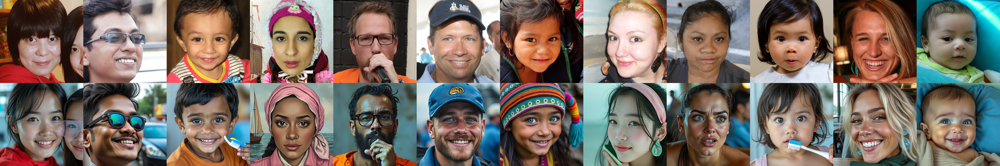

In [5]:
image_grid(img_lst+img_ai_lst, 2,12)

In [6]:
#load models
detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
# Create SIFT extractor
sift = cv2.SIFT_create()

In [15]:
i=0
img=img_ai_lst[i]
gray=np.array(img.convert('L'))

In [8]:
faces = detector(gray)

In [9]:
def get_lndmrk(gray_image, faces):
    #get list of x,y landmark on image
    lndmrk_lst=[]
    for i, face in enumerate(faces):
        #print(i)
        # Get the 68 landmarks
        shape = predictor(gray_image, face)
        lndmrk = [(shape.part(i).x, shape.part(i).y) for i in range(68)]
        lndmrk_lst+=lndmrk
    return lndmrk_lst

In [10]:
lndmrk_lst=get_lndmrk(gray, faces);
lndmrk_lst

[(97, 232),
 (103, 274),
 (113, 315),
 (126, 355),
 (148, 390),
 (181, 420),
 (219, 443),
 (258, 461),
 (293, 460),
 (323, 448),
 (344, 420),
 (361, 390),
 (378, 360),
 (390, 328),
 (397, 294),
 (399, 259),
 (396, 224),
 (144, 200),
 (167, 183),
 (197, 176),
 (226, 177),
 (253, 186),
 (305, 184),
 (326, 174),
 (348, 170),
 (368, 171),
 (383, 183),
 (285, 224),
 (289, 254),
 (294, 283),
 (299, 312),
 (260, 329),
 (277, 332),
 (294, 335),
 (307, 330),
 (319, 325),
 (180, 230),
 (197, 217),
 (217, 217),
 (235, 233),
 (217, 235),
 (196, 235),
 (315, 230),
 (329, 211),
 (348, 209),
 (363, 220),
 (351, 228),
 (332, 230),
 (213, 363),
 (244, 355),
 (273, 350),
 (290, 353),
 (304, 348),
 (322, 350),
 (339, 353),
 (323, 383),
 (307, 399),
 (290, 403),
 (272, 403),
 (242, 392),
 (221, 364),
 (273, 362),
 (290, 363),
 (305, 360),
 (331, 356),
 (305, 380),
 (290, 384),
 (272, 384)]

In [144]:
def show_lndmrk(image, landmarks):
    img_bgr=cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    for (x, y) in landmarks:
        cv2.circle(img_bgr, (x, y), 5, (0, 255, 0), -1)
    
    return Image.fromarray(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))

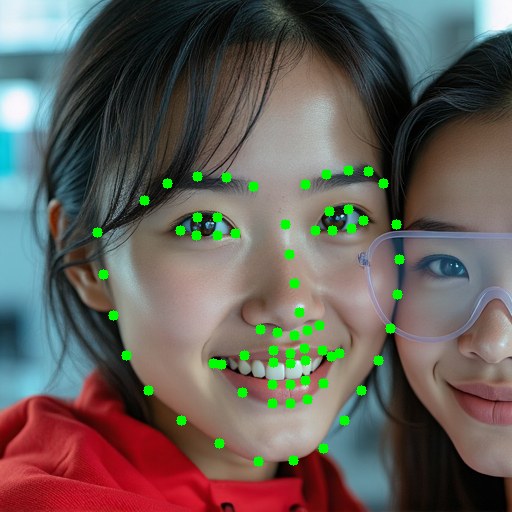

In [12]:
show_lndmrk(img, lndmrk_lst)

In [13]:
cv2_keypoints = [cv2.KeyPoint(x=float(x), y=float(y), size=1) for (x, y) in lndmrk_lst]
kpt, descriptors = sift.compute(gray, cv2_keypoints)
descriptors.shape

(68, 128)

In [16]:

df_dscriptr=pd.DataFrame(descriptors, columns=[str(i) for i in range(128)])
df_xy=pd.DataFrame(lndmrk_lst, columns=['x','y']) 
df_xy['is_AI'] = True if i >=len(names) else False
df_xy['fname'] = names[i%len(names)] # wrapped list
_df=pd.concat([df_xy, df_dscriptr], axis=1)
_df.head()

,x,y,is_AI,fname,0,1,2,3,4,5,...,118,119,120,121,122,123,124,125,126,127
0,97,232,False,00008,0.0,0.0,3.0,45.0,5.0,0.0,...,32.0,29.0,0.0,0.0,0.0,2.0,1.0,1.0,42.0,121.0
1,103,274,False,00008,0.0,0.0,0.0,0.0,70.0,82.0,...,0.0,0.0,112.0,31.0,0.0,0.0,2.0,7.0,0.0,2.0
2,113,315,False,00008,2.0,55.0,44.0,0.0,0.0,0.0,...,0.0,0.0,125.0,80.0,0.0,0.0,0.0,0.0,0.0,0.0
3,126,355,False,00008,60.0,43.0,0.0,0.0,0.0,0.0,...,0.0,0.0,96.0,98.0,0.0,0.0,0.0,0.0,0.0,0.0
4,148,390,False,00008,17.0,141.0,0.0,0.0,0.0,0.0,...,0.0,0.0,13.0,139.0,0.0,0.0,0.0,0.0,0.0,0.0


In [17]:
#sanity check
for i, img in enumerate(img_lst+img_ai_lst):
    is_AI = True if i >=len(names) else False
    stem = names[i%len(names)]
    print(is_AI,stem)

False 00008
False 00009
False 00010
False 00004
False 00005
False 00011
False 00007
False 00006
False 00002
False 00003
False 00001
False 00000
True 00008
True 00009
True 00010
True 00004
True 00005
True 00011
True 00007
True 00006
True 00002
True 00003
True 00001
True 00000


In [18]:
cols=['x','y', 'is_AI', 'fname']+[str(i) for i in range(128)]
df=pd.DataFrame([], columns=cols)

In [19]:
pd.concat([df, _df], axis=0, ignore_index=True)

/var/folders/jp/2lwscxf50n52zn27l26vj6r00000gq/T/ipykernel_95402/4048043510.py:1: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  pd.concat([df, _df], axis=0, ignore_index=True)


,x,y,is_AI,fname,0,1,2,3,4,5,...,118,119,120,121,122,123,124,125,126,127
0,97,232,False,00008,0.0,0.0,3.0,45.0,5.0,0.0,...,32.0,29.0,0.0,0.0,0.0,2.0,1.0,1.0,42.0,121.0
1,103,274,False,00008,0.0,0.0,0.0,0.0,70.0,82.0,...,0.0,0.0,112.0,31.0,0.0,0.0,2.0,7.0,0.0,2.0
2,113,315,False,00008,2.0,55.0,44.0,0.0,0.0,0.0,...,0.0,0.0,125.0,80.0,0.0,0.0,0.0,0.0,0.0,0.0
3,126,355,False,00008,60.0,43.0,0.0,0.0,0.0,0.0,...,0.0,0.0,96.0,98.0,0.0,0.0,0.0,0.0,0.0,0.0
4,148,390,False,00008,17.0,141.0,0.0,0.0,0.0,0.0,...,0.0,0.0,13.0,139.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,305,360,False,00008,0.0,0.0,0.0,0.0,0.0,0.0,...,20.0,128.0,2.0,0.0,0.0,0.0,0.0,0.0,21.0,93.0
64,331,356,False,00008,0.0,0.0,134.0,66.0,0.0,0.0,...,41.0,134.0,1.0,0.0,0.0,0.0,0.0,0.0,13.0,134.0
65,305,380,False,00008,0.0,0.0,0.0,0.0,9.0,85.0,...,145.0,5.0,0.0,0.0,0.0,0.0,0.0,77.0,145.0,0.0
66,290,384,False,00008,0.0,16.0,79.0,87.0,1.0,0.0,...,128.0,128.0,0.0,0.0,0.0,0.0,0.0,0.0,85.0,128.0


In [130]:
img_lndmrk_lst=[]

for i, img in enumerate(img_lst+img_ai_lst):
    is_AI=True if i >=len(names) else False
    fname=names[i%len(names)] # wrapped list
    
    gray=np.array(img.convert('L'))
    faces = detector(gray)
    lndmrk_lst=get_lndmrk(gray, faces)
    
    #see results
    img_lndmrk_lst.append(show_lndmrk(img, lndmrk_lst))
    #turn into cv keypoint
    cv2_keypoints = [cv2.KeyPoint(x=float(x), y=float(y), size=1) for (x, y) in lndmrk_lst]
    #get sift feature descriptors
    kpt, descriptors = sift.compute(gray, cv2_keypoints)

    df_xy=pd.DataFrame(lndmrk_lst, columns=['x','y']) 
    if len(df_xy)>0:
        df_xy['is_AI'] = is_AI
        df_xy['fname'] = fname 
                              
        df_dscriptr=pd.DataFrame(descriptors, columns=[str(i) for i in range(128)])
        _df=pd.concat([df_xy, df_dscriptr], axis=1)
        
        if i == 0: df=_df.copy()
        else: df=pd.concat([df, _df], axis=0, ignore_index=True)
    else: 
        print(f'No keypoints/ descriptor features at {fname} AI: {is_AI}')

No keypoints/ descriptor features at 00009 AI: True


In [2]:
image_grid(img_lndmrk_lst, 2,12)

In [132]:
f_idx=[0,3,5,6,7,8,11]


In [133]:
df=df[df['fname'].isin([names[o] for o in f_idx])].copy()

In [1]:
# my validation images
vld_idx=[5,8]
print([names[i] for i in vld_idx])

image_grid([x for i in vld_idx for x in [img_lst[i], img_ai_lst[i]]], 2,2)

In [135]:
df['is_vld']=False
df.loc[df[df['fname'].isin([names[i] for i in vld_idx])].index, 'is_vld']=True

In [136]:
df

,x,y,is_AI,fname,0,1,2,3,4,5,...,119,120,121,122,123,124,125,126,127,is_vld
0,103,239,False,00008,0.0,0.0,0.0,71.0,126.0,3.0,...,114.0,20.0,0.0,0.0,0.0,11.0,34.0,5.0,65.0,False
1,107,279,False,00008,51.0,0.0,0.0,0.0,0.0,0.0,...,6.0,147.0,0.0,0.0,0.0,0.0,0.0,0.0,11.0,False
2,114,318,False,00008,59.0,11.0,0.0,0.0,0.0,0.0,...,0.0,138.0,32.0,0.0,0.0,0.0,0.0,0.0,0.0,False
3,120,356,False,00008,103.0,11.0,0.0,0.0,0.0,0.0,...,0.0,137.0,46.0,0.0,0.0,0.0,0.0,0.0,0.0,False
4,137,391,False,00008,50.0,112.0,0.0,0.0,0.0,0.0,...,0.0,35.0,113.0,0.0,0.0,0.0,0.0,0.0,0.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1559,261,350,True,00000,0.0,0.0,41.0,116.0,7.0,0.0,...,0.0,0.0,0.0,0.0,19.0,111.0,60.0,0.0,0.0,False
1560,287,353,True,00000,11.0,116.0,39.0,0.0,0.0,0.0,...,124.0,0.0,0.0,0.0,0.0,0.0,0.0,68.0,124.0,False
1561,261,361,True,00000,0.0,0.0,10.0,38.0,25.0,10.0,...,0.0,0.0,0.0,0.0,0.0,0.0,7.0,139.0,0.0,False
1562,249,363,True,00000,0.0,0.0,16.0,12.0,0.0,23.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,105.0,3.0,False


In [137]:
df_train = df[df['is_vld']==False].copy()
df_vld = df[df['is_vld']==True].copy()
cols=[str(i) for i in range(128)]

X_train=df_train[cols].to_numpy()/255
X_vld=df_vld[cols].to_numpy()/255

y_train=df_train['is_AI'].to_numpy().tolist()
y_vld=df_vld['is_AI'].to_numpy().tolist()

X_train.shape, X_vld.shape

((680, 128), (272, 128))

In [95]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [171]:
# Define and train model
clf = MLPClassifier(hidden_layer_sizes=(512, 256, 128), max_iter=500, random_state=42)
clf.fit(X_train, y_train)

# Evaluate
y_pred = clf.predict(X_vld)
print(classification_report(y_vld, y_pred))

              precision    recall  f1-score   support

       False       0.50      0.53      0.51       136
        True       0.50      0.46      0.48       136

    accuracy                           0.50       272
   macro avg       0.50      0.50      0.50       272
weighted avg       0.50      0.50      0.50       272



In [172]:
def show_preds(image, frame):
    img_bgr=cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    for idx in frame.index:
        x=frame.loc[idx, 'x']
        y=frame.loc[idx, 'y']
        clr=frame.loc[idx, 'color']
        if clr: #green if correct
            cv2.circle(img_bgr, (x, y), 5, (0, 255, 0), -1)
        else: # red == Wrong   
            cv2.circle(img_bgr, (x, y), 5, (0, 0, 255), -1)
    
    return Image.fromarray(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))

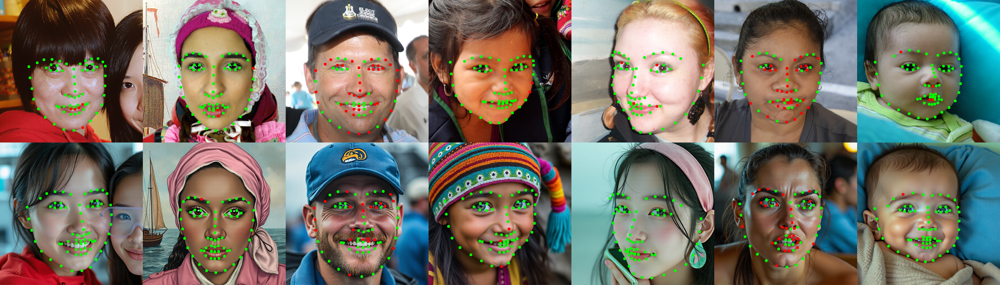

In [173]:
lst=[]
for i, img in enumerate(img_lst+img_ai_lst):
    is_AI = True if i >=len(names) else False
    stem = names[i%len(names)]
    
    if stem in df['fname'].unique():
        #pred: True if AI False if not AI
        frame=df[(df['fname']==stem)&(df['is_AI']==is_AI )].copy()
        df.loc[frame.index,'pred']=clf.predict((frame[[str(i) for i in range(128)]]/255).to_numpy())
        frame['color']=(frame['is_AI']== frame['pred'])
        lst.append(show_preds(img, frame))
# red == wrong prediction
image_grid(lst, 2,7)       

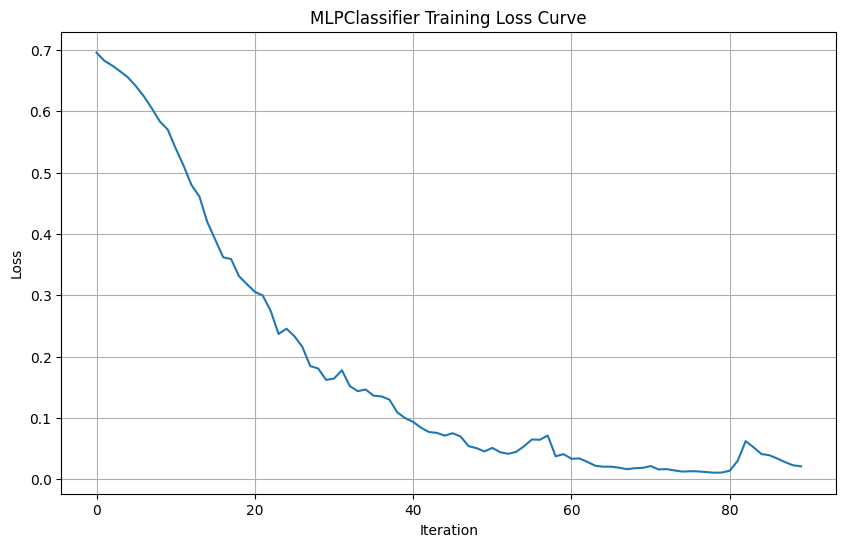

In [176]:

plt.figure(figsize=(10, 6))
plt.plot(clf.loss_curve_)
plt.title('MLPClassifier Training Loss Curve')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True)
plt.show()

In [170]:
import datetime as dt
end=dt.datetime.now()
print(f'Finished: {end.strftime("%A %B %d, %Y")} at {end.strftime("%H:%M")}')

Finished: Wednesday August 20, 2025 at 14:05
